# Проектная работа

# Рынок заведений общественного питания Москвы

**Цель исследования**

Подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

**Входные данные**

Нам доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. 

Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

Описание данных:

- name — название заведения
- address — адрес заведения
- category — категория заведения, например «кафе», «пиццерия» или «кофейня»
- hours — информация о днях и часах работы
- lat — широта географической точки, в которой находится заведение
- lng — долгота географической точки, в которой находится заведение
- rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0)
- price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее
- avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона
- middle_avg_bill — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»
- middle_coffee_cup — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»
- chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки)
- district — административный район, в котором находится заведение, например Центральный административный округ
- seats — количество посадочных мест

**Описание проекта** 

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

## Загрузка данных и изучение общей информации

Импортируем необходимые библиотеки.

In [1]:
#help('modules')

In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px
from IPython.core.display import display, HTML
import matplotlib.pyplot as plt
import re
import json
from folium import Map, Marker, Figure
from folium.plugins import MarkerCluster
import plotly.graph_objects as go
from collections import Counter
from plotly.subplots import make_subplots
import warnings
warnings.simplefilter('ignore')


In [3]:
pip install geojson

Note: you may need to restart the kernel to use updated packages.


Открываем файл с данными.

In [4]:
try:
    df = pd.read_csv('/datasets/moscow_places.csv')
except:
    df = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

Выведем основную информацию о датафрейме с помощью метода info()

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Выведем первые 20 строчек датафрейма df на экран.

In [6]:
df.head(20)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0


Выведем последние 20 строчек датафрейма df на экран.

In [7]:
df.tail(20)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
8386,Греки Здесь,ресторан,"Москва, улица Авиаконструктора Миля, 3А",Юго-Восточный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.686520,37.851790,4.1,NaN,NaN,NaN,NaN,0,NaN
8387,Pab&burg,"бар,паб","Москва, улица Михайлова, 22, корп. 4",Юго-Восточный административный округ,"ежедневно, 12:00–21:30",55.726303,37.769842,4.2,средние,Цена бокала пива:от 140 ₽,NaN,NaN,0,NaN
8388,Белое озеро,ресторан,"Москва, Большая Косинская улица, 24А",Восточный административный округ,"ежедневно, 11:00–23:00",55.714381,37.855541,3.9,NaN,NaN,NaN,NaN,0,40.0
8389,Assa,ресторан,"Москва, улица Авиаконструктора Миля, 3А",Юго-Восточный административный округ,"пн-чт 09:00–22:00; пт,сб 09:00–23:00; вс 09:00...",55.686817,37.851225,4.9,NaN,NaN,NaN,NaN,0,NaN
8390,Кафе Печкин,ресторан,"Москва, Зеленодольская улица, 32, корп. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.710550,37.769019,4.2,NaN,NaN,NaN,NaN,0,86.0
8391,Кафе Кенч,кафе,"Москва, 1-я Новокузьминская улица, 3",Юго-Восточный административный округ,"ежедневно, 11:00–00:00",55.716771,37.785316,2.8,NaN,NaN,NaN,NaN,0,45.0
8392,Касабланка,кафе,"Москва, Большая Косинская улица, 27",Восточный административный округ,пн-чт 08:00–17:00; пт 08:00–16:00,55.718514,37.857576,3.3,NaN,NaN,NaN,NaN,0,NaN
8393,Doner Pro,быстрое питание,"Москва, 11-я улица Текстильщиков, 1",Юго-Восточный административный округ,"ежедневно, 10:00–03:00",55.705155,37.736415,4.0,NaN,NaN,NaN,NaN,0,80.0
8394,Намангале,кафе,"Москва, Ферганская улица, вл17-21",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.705332,37.819244,4.3,NaN,NaN,NaN,NaN,0,NaN
8395,Истира Запрафка,кафе,"Москва, Юго-Восточный административный округ, ...",Юго-Восточный административный округ,NaN,55.724686,37.710558,2.9,NaN,NaN,NaN,NaN,0,NaN


Используем функцию describe() для создания описательной статистики данных нашей таблицы.

In [8]:
df.describe()

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.000000,8406.000000,8406.000000,3149.000000,535.000000,8406.000000,4795.000000
mean,55.750109,37.608570,4.229895,958.053668,174.721495,0.381275,108.421689
std,0.069658,0.098597,0.470348,1009.732845,88.951103,0.485729,122.833396
min,55.573942,37.355651,1.000000,0.000000,60.000000,0.000000,0.000000
25%,55.705155,37.538583,4.100000,375.000000,124.500000,0.000000,40.000000
50%,55.753425,37.605246,4.300000,750.000000,169.000000,0.000000,75.000000
75%,55.795041,37.664792,4.400000,1250.000000,225.000000,1.000000,140.000000
max,55.928943,37.874466,5.000000,35000.000000,1568.000000,1.000000,1288.000000


Сделаем рандомную выборку нашей таблицы.

In [9]:
df.sample()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3940,RICK's bar & bistro,"бар,паб","Москва, улица Остоженка, 30, стр. 1",Центральный административный округ,вт-чт 17:00–00:00; пт 17:00–03:00; сб 12:00–03...,55.739895,37.596338,4.7,высокие,NaN,NaN,NaN,0,120.0


**Промежуточный вывод:**

В нашем датасете представлено 8406 заведений общепита города Москва. Названия столбцов понятны, менять ничего не надо. Предоставленные данные вполне подходят для дальнейшего анализа. Столбцы хранят данные в форматах int, float, object.

## Предобработка данных

### Подготовка данных

Для начала переведем все строковые данные в нижний регистр, для удобства и универсальности.

In [10]:
for col in ['name', 'category', 'address', 'hours', 'price', 'avg_bill']:
    df[col] = df[col].str.lower()

Проверка полученных данных на ошибки.

In [11]:
def display_side_by_side(dfs: list, captions: list, space_width=10):
    output = ""
    combined = dict(zip(captions, dfs))

    for caption, df in combined.items():
        output += (df.style.set_properties(**{'text-align': 'left'})
                   .set_table_attributes("style='display:inline'")
                   .set_caption(caption)._repr_html_())
        output += "\xa0" * space_width

    display(HTML(output))

,0
0,Северный административный округ
1,Северо-Восточный административный округ
2,Северо-Западный административный округ
3,Западный административный округ
4,Центральный административный округ
5,Восточный административный округ
6,Юго-Восточный административный округ
7,Южный административный округ
8,Юго-Западный административный округ
,0


Разброс координат по ширине и долготе:


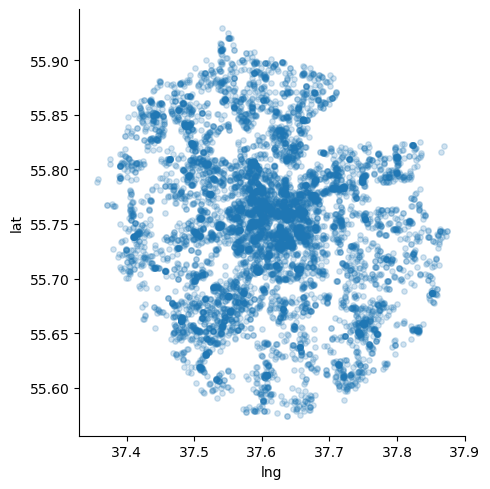

In [12]:
display_side_by_side([
    pd.DataFrame(df['district'].unique()),
    pd.DataFrame(df['category'].unique()),
    pd.DataFrame(df['rating'].describe())
],
    [
    'Уникальные названия административных районов Москвы',
    'Уникальные названия категорий заведений',
    'Статистика по рейтингу'
], 10)
print('Разброс координат по ширине и долготе:')
sns.lmplot(x="lng", y="lat", data=df, fit_reg=False,
           scatter_kws={'s': 15, 'alpha': 0.2});

Исходя из полученных результатов:

- Названия административных райнов совпадают с действующими районами Москвы
- Категории заведений разбиты логично, ничего лишнего
- рейтинг заведений по оценкам пользователей в Яндекс Картах не имеет аномальных значений
- координаты по ширине и долготе образуют собой карту Москвы, что очевидно можно увидеть на графике

### Изучение пропущенных значений в столбцах

Выведем количество пропущенных значений для каждого столбца. Используем комбинацию трёх методов.

In [13]:
df.isnull().sum().sort_values()

name                    0
category                0
address                 0
district                0
lat                     0
lng                     0
rating                  0
chain                   0
hours                 536
seats                3611
avg_bill             4590
price                5091
middle_avg_bill      5257
middle_coffee_cup    7871
dtype: int64

Отобразим в процентном соотношении.

In [14]:
columns = df.columns

for col in columns:
    nan_percentage = (df[col].isnull().sum()/len(df))*100  
    if nan_percentage > 0:
        print(f'{col}: {nan_percentage:.2f}%')

hours: 6.38%
price: 60.56%
avg_bill: 54.60%
middle_avg_bill: 62.54%
middle_coffee_cup: 93.64%
seats: 42.96%


Проверим датасет на наличие дубликатов.

In [15]:
df.duplicated().sum()

0

Дубликатов нет. Отлично.

Проверим на неявные дубли колонку name.

In [16]:
df['name'].duplicated().sum()

2894

In [17]:
duplicated_names = df[df['name'].duplicated() == True]['name']

In [18]:
duplicated_names.head(20)

23              буханка
47                 кафе
71             cofefest
75        хинкали-gали!
91               шашлык
94       домино'с пицца
95           додо пицца
96             cofefest
108                кафе
118            cofefest
119          додо пицца
123                кафе
141                кафе
142           кулинария
148              халяль
159                кафе
161      домино'с пицца
169      домино'с пицца
171    one price coffee
177              арамье
Name: name, dtype: object

In [19]:
df.query('name == "cofefest"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
46,cofefest,кофейня,"москва, улица маршала федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,1,NaN
71,cofefest,кофейня,"москва, новгородская улица, 23а",Северо-Восточный административный округ,пн-пт 08:00–19:00,55.901799,37.577672,4.1,NaN,NaN,NaN,NaN,1,NaN
96,cofefest,кофейня,"москва, улица пришвина, 8",Северо-Восточный административный округ,пн-пт 08:00–19:00,55.888942,37.595195,4.3,NaN,NaN,NaN,NaN,1,NaN
118,cofefest,кофейня,"москва, дубнинская улица, 40, корп. 3",Северный административный округ,пн-пт 09:00–18:00,55.889336,37.561877,4.1,NaN,NaN,NaN,NaN,1,NaN
187,cofefest,кофейня,"москва, инженерная улица, 3с1",Северо-Восточный административный округ,пн-пт 08:00–19:00,55.878440,37.580627,2.9,NaN,NaN,NaN,NaN,1,NaN
833,cofefest,кофейня,"москва, 3-й новомихалковский проезд, 3а, стр. 1",Северный административный округ,пн-пт 08:00–19:00,55.839749,37.542662,4.6,NaN,NaN,NaN,NaN,1,NaN
1506,cofefest,кофейня,"москва, новощукинская улица, 10, корп. 1",Северо-Западный административный округ,пн-пт 08:00–19:00,55.806191,37.455813,4.0,NaN,NaN,NaN,NaN,1,NaN
2068,cofefest,кофейня,"москва, 4-я улица 8 марта, 6а",Северный административный округ,пн-пт 08:00–19:00,55.803654,37.550203,3.9,NaN,NaN,NaN,NaN,1,90.0
2412,cofefest,кофейня,"москва, улица матросская тишина, 14",Восточный административный округ,пн-пт 08:00–19:00,55.789709,37.694810,4.2,NaN,NaN,NaN,NaN,1,NaN
2422,cofefest,кофейня,"москва, улица бочкова, 5, корп. 3",Северо-Восточный административный округ,пн-пт 08:00–19:00,55.809525,37.631604,3.9,NaN,NaN,NaN,NaN,1,126.0


In [20]:
df.query('name == "кафе"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
40,кафе,кафе,"москва, ижорская улица, 18, стр. 1",Северный административный округ,NaN,55.895115,37.524902,3.7,NaN,NaN,NaN,NaN,0,NaN
47,кафе,кафе,"москва, улица маршала федоренко, 7",Северный административный округ,"ежедневно, 11:00–00:00",55.880306,37.489760,2.8,NaN,NaN,NaN,NaN,0,35.0
108,кафе,"бар,паб","москва, мкад, 82-й километр, вл18",Северо-Восточный административный округ,NaN,55.908930,37.558777,4.2,NaN,NaN,NaN,NaN,0,NaN
123,кафе,кафе,"москва, шенкурский проезд, 14",Северо-Восточный административный округ,NaN,55.897794,37.591395,4.3,NaN,NaN,NaN,NaN,0,50.0
141,кафе,кафе,"москва, дубнинская улица, 52, стр. 1",Северный административный округ,"ежедневно, 10:00–20:00",55.896020,37.556072,3.9,NaN,NaN,NaN,NaN,0,70.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7900,кафе,кафе,"москва, ореховый бульвар, 28",Южный административный округ,NaN,55.616527,37.764003,3.9,NaN,NaN,NaN,NaN,0,15.0
7931,кафе,кафе,"москва, каширское шоссе, 67а",Южный административный округ,NaN,55.596680,37.725980,4.0,NaN,NaN,NaN,NaN,0,NaN
7938,кафе,кафе,"москва, улица генерала белова, 28, корп. 1",Южный административный округ,NaN,55.604990,37.724762,4.5,NaN,NaN,NaN,NaN,0,NaN
7945,кафе,кафе,"москва, мкад, 19-й километр, вл20с1",Южный административный округ,NaN,55.621773,37.781727,4.0,NaN,NaN,NaN,NaN,0,NaN


In [21]:
df.query('name == "додо пицца"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
32,додо пицца,пиццерия,"москва, коровинское шоссе, 23, корп. 1",Северный административный округ,"ежедневно, 09:00–23:00",55.877388,37.523334,4.3,NaN,средний счёт:328 ₽,328.0,NaN,1,46.0
95,додо пицца,пиццерия,"москва, дубнинская улица, 50",Северный административный округ,"ежедневно, 09:00–23:00",55.893672,37.558562,4.3,NaN,средний счёт:349 ₽,349.0,NaN,1,50.0
119,додо пицца,пиццерия,"москва, алтуфьевское шоссе, 70, корп. 1",Северо-Восточный административный округ,"ежедневно, 09:00–23:00",55.887963,37.587999,4.3,NaN,средний счёт:355 ₽,355.0,NaN,1,120.0
256,додо пицца,пиццерия,"москва, широкая улица, 27",Северо-Восточный административный округ,"пн-пт 09:00–23:00; сб,вс 10:00–23:00",55.887725,37.675675,4.3,NaN,средний счёт:362 ₽,362.0,NaN,1,15.0
275,додо пицца,пиццерия,"москва, улица лескова, 19а, стр. 2",Северо-Восточный административный округ,"ежедневно, 09:00–00:00",55.894313,37.616953,4.2,NaN,средний счёт:291 ₽,291.0,NaN,1,110.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7819,додо пицца,пиццерия,"москва, бирюлёвская улица, 51",Южный административный округ,"ежедневно, 09:00–22:00",55.582548,37.671247,4.5,NaN,средний счёт:372 ₽,372.0,NaN,1,NaN
7883,додо пицца,пиццерия,"москва, воронежская улица, 36, корп. 1",Южный административный округ,"ежедневно, 10:00–22:30",55.610367,37.740345,4.3,NaN,средний счёт:340 ₽,340.0,NaN,1,8.0
7904,додо пицца,пиццерия,"москва, каширское шоссе, 65, корп. 3",Южный административный округ,"ежедневно, 10:00–22:30",55.599107,37.725068,4.4,NaN,средний счёт:475 ₽,475.0,NaN,1,160.0
7934,додо пицца,пиццерия,"москва, домодедовская улица, 42а",Южный административный округ,"ежедневно, 10:00–22:30",55.602779,37.713818,4.3,NaN,средний счёт:432 ₽,432.0,NaN,1,9.0


Проверка на неявные дубли выявила, что наименования заведений повторяются. Это подтверждается тем, что это названия сетей общепита. Удостоверились в этом, выведя списки с этими названиями. Названия одни, а адреса разные.

Проверим на неявные дубли колонку address.

In [22]:
df['address'].duplicated().sum()

2654

In [23]:
duplicated_address = df[df['address'].duplicated() == True]['address']

In [24]:
duplicated_address.head(20)

7        москва, клязьминская улица, 9, стр. 3
20             москва, правобережная улица, 1б
31                  москва, улица дыбенко, 7/1
41                  москва, улица дыбенко, 7/1
48            москва, улица дыбенко, 7, стр. 1
52                  москва, улица дыбенко, 7/1
53             москва, правобережная улица, 1б
54       москва, коровинское шоссе, 46, стр. 5
55             москва, правобережная улица, 1б
56       москва, коровинское шоссе, 46, стр. 5
70     москва, алтуфьевское шоссе, 70, корп. 1
82                москва, дубнинская улица, 32
99                москва, дубнинская улица, 32
107    москва, алтуфьевское шоссе, 86, корп. 1
108          москва, мкад, 82-й километр, вл18
109    москва, алтуфьевское шоссе, 70, корп. 1
112    москва, алтуфьевское шоссе, 70, корп. 1
113                  москва, улица лескова, 14
114    москва, алтуфьевское шоссе, 86, корп. 1
119    москва, алтуфьевское шоссе, 70, корп. 1
Name: address, dtype: object

In [25]:
df.query('address == "москва, клязьминская улица, 9, стр. 3"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6,огни города,"бар,паб","москва, клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,средний счёт:199 ₽,199.0,NaN,0,45.0
7,mr. уголёк,быстрое питание,"москва, клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,средний счёт:200–300 ₽,250.0,NaN,0,45.0


In [26]:
df.query('address == "москва, улица дыбенко, 7/1"')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
31,алталия,быстрое питание,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878691,37.478993,4.1,NaN,NaN,NaN,NaN,0,NaN
41,крошка картошка,быстрое питание,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878515,37.479308,4.1,NaN,NaN,NaN,NaN,1,NaN
52,cofix,кофейня,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,1,NaN


Проверка на неявные дубли выявила, что названия улиц повторяются. Проверив, выведя несколько одинаковых улиц мы можем увидеть, что на одной улице расположено несколько завдений общепита разных категорий. 

Выведем столбцы с пропусками в данных и посмотрим возможно ли заполнить эти пропуски какими-либо значениями.

In [27]:
df[['hours', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup', 'seats']].head(10)

,hours,price,avg_bill,middle_avg_bill,middle_coffee_cup,seats
0,"ежедневно, 10:00–22:00",NaN,NaN,NaN,NaN,NaN
1,"ежедневно, 10:00–22:00",выше среднего,средний счёт:1500–1600 ₽,1550.0,NaN,4.0
2,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",средние,средний счёт:от 1000 ₽,1000.0,NaN,45.0
3,"ежедневно, 09:00–22:00",NaN,цена чашки капучино:155–185 ₽,NaN,170.0,NaN
4,"ежедневно, 10:00–22:00",средние,средний счёт:400–600 ₽,500.0,NaN,148.0
5,"ежедневно, 10:00–23:00",средние,NaN,NaN,NaN,NaN
6,пн 15:00–04:00; вт-вс 15:00–05:00,средние,средний счёт:199 ₽,199.0,NaN,45.0
7,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",средние,средний счёт:200–300 ₽,250.0,NaN,45.0
8,"ежедневно, 10:00–22:00",средние,средний счёт:от 500 ₽,500.0,NaN,79.0
9,"ежедневно, 12:00–00:00",средние,средний счёт:1000–1200 ₽,1100.0,NaN,65.0


Процентное соотношение пропущенных значений выглядит так:
- middle_coffee_cup: 93.64%
- middle_avg_bill: 62.54%
- price: 60.56%
- avg_bill: 54.60%
- seats: 42.96%
- hours: 6.38%

Пропуски в колонке к price - категория цен в заведении предугадать сложно, но вполне возможно в дальнейшем заполнить данными с привязкой к district. 

Пропуски в колонке seats - количество посадочных мест предсказать тоже сложно, пожалуй отсавим пропуски как есть.

Пропуски в колонке hours - информация о днях и часах работы мне не представляется возможным заполнить, но так как их количество минимальное, оставим как есть.

Пропуски у колонках middle_coffee_cup, middle_avg_bill, avg_bill - возможно мне кажется заполнить пропуски, по аналогии с price.

### Создадим столбец street с названием из столбца с адресом

Создадим функцию, которая отредактирует и выведет только название улицы из столбца address.

In [28]:
def get_street(address):
    address = address.strip().lower()
    address = re.sub(r'\s*,\s*', ',', address)
    address = re.split(',|\.', address)
    return address[1]

Применим функцию к столбцу address и создадим новый столбец street.

In [29]:
df['street'] = df['address'].apply(get_street)

Проверим полученный результат.

In [30]:
df['street'].sample(5)

6277                  усачёва улица
4753                ладожская улица
3943               смоленская улица
1295            волоколамское шоссе
4521    нижняя красносельская улица
Name: street, dtype: object

### Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7)

Создадим функцию которая выведет нам логическое значения True — если заведение работает ежедневно и круглосуточно и
логическое значение False — в противоположном случае.

In [31]:
def is_24_7(time):
    if time != time:
        return np.nan
    elif time == 'ежедневно, круглосуточно':
        return True
    else:
        return False

Применим функцию к столбцу hours, тем самым создадим новый столбец is_24_7.

In [32]:
df['is_24_7'] = df['hours'].apply(is_24_7)

Проверим полученный результат.

In [33]:
df.sample(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
2581,кафе бульвар. шашлык-сити,кафе,"москва, 7-я парковая улица, 15, стр. 3",Восточный административный округ,"ежедневно, 11:00–00:00",55.797201,37.793022,4.3,NaN,NaN,NaN,NaN,0,NaN,7-я парковая улица,False
103,тетри,быстрое питание,"москва, лианозовский проезд, вл1",Северо-Восточный административный округ,вт-вс 09:00–19:00,55.896922,37.554929,4.0,средние,средний счёт:150–250 ₽,200.0,NaN,0,NaN,лианозовский проезд,False
163,wild bean cafe,кафе,"москва, улица плещеева, 2, стр. 1",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.882732,37.604527,4.1,NaN,NaN,NaN,NaN,1,25.0,улица плещеева,True
2913,хаус бар,"бар,паб","москва, измайловское шоссе, 71, корп. 2б",Восточный административный округ,"ежедневно, 07:00–23:00",55.789639,37.747274,3.7,средние,средний счёт:500–1000 ₽,750.0,NaN,0,660.0,измайловское шоссе,False
607,captain gyros,ресторан,"москва, тушинская улица, 24с16",Северо-Западный административный округ,"ежедневно, 07:00–22:00",55.828276,37.439134,4.1,средние,средний счёт:195–235 ₽,215.0,NaN,0,NaN,тушинская улица,False


**Вывод:**

- Все строковые данные были переведены в нижний регистр
- Дубликатов найдено не было
- Восстановить пропуски на данный момент нет возможности, как и причины, возможно стоит вернутся к этому вопросу позже
- Ошибок в данных найдено не было
- Были добавлены столбцы с названиями улиц и с маркером работы 24/7

## Анализ данных

### Анализ категорий заведений

Проанализируем категории заведений представленные в таблице. Исследуем количество объектов общественного питания в городе Москва по категориям. Построим визуализацию по процентному соотношению заведений по категориям.

In [34]:
category = pd.DataFrame(df.groupby('category')['category'].count())
fig = px.pie(category, values='category', names=category.index, hole=0.6,)
fig.update_layout(
    height=450,
    showlegend=True,
    legend_title='Категории заведений',
    annotations=[dict(text='Соотношение<br>заведений<br>по категориям', x=0.5, y=0.5, font_size=18, showarrow=False)],
    legend_orientation="h"
)

fig.show()

In [35]:
def one_plot_creator(df, x, y, color, text=None,
                     title='default tittle', xaxis_title='default xaxis tittle', yaxis_title='default yaxis tittle',
                     legend_title='default legend tittle', barmode='stack',
                     orientation='v', height=500, showlegend=True, for_export=False):

    fig = px.bar(df, x=x, y=y, color=color, text=text, barmode=barmode)

    fig.update_layout(
        height=height,
        showlegend=showlegend,
        title=title,
        xaxis_title=xaxis_title,
        yaxis_title=yaxis_title,
        legend_title=legend_title
    )
    
    if for_export == True:
        fig.update_layout({
            'plot_bgcolor': 'rgba(0, 0, 0, 0)',
            'paper_bgcolor': 'rgba(0, 0, 0, 0)',
        })

    return fig

In [36]:
fig = one_plot_creator(
    df=df.groupby(['category'], 
                  as_index=False).agg(count=('category', 'count')).sort_values('count', ascending=False),
    x='category', y='count', color='category',
    title='Количество заведений по категориям',
    xaxis_title='Категории заведений',
    yaxis_title='Количество заведений',
    legend_title='Категории заведений',
    barmode='group',
    height=450
    
)
fig.show()

**Вывод:**
Список заведений по категориям (по убыванию количества):

- 28.3% - кафе - 2378 заведений
- 24.3% - ресторан - 2043 заведений
- 16.8% - кофейня - 1413 заведений
- 9.1% - бар/паб - 765 заведений
- 7.53% - пиццерия - 633 заведений
- 7.17% - бвстрое питание - 603 заведений
- 3.75% - столовая - 315 заведений
- 3.05%- булочная - 256 заведений

Рейтинг заведений общепита по категориям выглядит правдободобным. Первые три места занимают традиционно: кафе, рестораны и кофейни. Это самые популярные категории общепита, остальные категории намного уступают лидерам.

### Анализ по количеству посадочных мест по категориям заведений

Проанализируем количество посадочных мест в местах по категориям. Построим визуализацию.

Разобьем все кафе по категориям по количеству посадочных мест, категории выделим на основе информации о всех кафе.

In [37]:
def categorization_seats(seats):
    if (seats != seats):
        return np.nan
    seats = int(seats)
    if (seats == 0):
        return '0 (без мест)'
    elif (seats <= 20):
        return '1 - 20 (небольшое)'
    elif (seats <= 80):
        return '21 - 80 (среднее)'
    elif (seats <= 120):
        return '81 - 120 (большое)'
    else:
        return '121 + (очень большое)'

Выведем статистические данные по количеству посадочных мест.

In [38]:
df.groupby(by='category', as_index=False).agg(
    min=('seats', 'min'),
    max=('seats', 'max'),
    mean=('seats', 'mean'),
    median=('seats', 'median')
)

,category,min,max,mean,median
0,"бар,паб",0.0,1288.0,124.532051,82.5
1,булочная,0.0,625.0,89.385135,50.0
2,быстрое питание,0.0,1040.0,98.891117,65.0
3,кафе,0.0,1288.0,97.512315,60.0
4,кофейня,0.0,1288.0,111.199734,80.0
5,пиццерия,0.0,1288.0,94.496487,55.0
6,ресторан,0.0,1288.0,121.944094,86.0
7,столовая,0.0,1200.0,99.750000,75.5


Выделим следующие категории:

- 0 - заведения без посадочных мест
- 0-20 - заведения небольшого размера
- 20-80 - заведения среднего размера
- 80-120 - заведения большого размера
- 120+ - очень большие заведения

Применим функцию к столбцу seats.

In [39]:
df['seats_category'] = df['seats'].apply(categorization_seats)

Создадим функцию для создания графиков, к которой в последующем будем применять необходимые аргументы.

In [40]:
def one_plot_creator(df, x, y, color, text=None,
                     title='default tittle', xaxis_title='default xaxis tittle', yaxis_title='default yaxis tittle',
                     legend_title='default legend tittle', barmode='stack',
                     orientation='v', height=500, showlegend=True, for_export=False):

    fig = px.bar(df, x=x, y=y, color=color, text=text, barmode=barmode)

    fig.update_layout(
        height=height,
        showlegend=showlegend,
        title=title,
        xaxis_title=xaxis_title,
        yaxis_title=yaxis_title,
        legend_title=legend_title
    )
    
    if for_export == True:
        fig.update_layout({
            'plot_bgcolor': 'rgba(0, 0, 0, 0)',
            'paper_bgcolor': 'rgba(0, 0, 0, 0)',
        })

    return fig

Применим функцию для построения графика распределения количества мест в заведениях по категориям.

In [41]:
fig = one_plot_creator(
    df=df.groupby(['category', 'seats_category'], 
                  as_index=False).agg(count=('category', 'count')).sort_values('count', ascending=False),
    x='category', y='count', color='seats_category',
    title='Распределение количества мест в заведениях по категориям',
    xaxis_title='Категории заведений',
    yaxis_title='Количество заведений',
    legend_title='Категории по количеству мест',
    barmode='group',
    height=450
)
fig.show()

**Вывод:**

На графике хорошо видно:

- Во всех категориях заведений доминирует категория заведений среднего размера (от 21 до 80 посадочных мест)
- На втором месте из всех категорий идут заведения очень большего размера (от 121 посадочного места)
- Замыкают тройку заведения большего размера (от 81 до 120 посадочных мест)
- Заведения маленького размера находятся на предпоследнем месте среди категорий (от 1 до 20 посадочных мест)
- Меньше всего заведений без посадочных мест как и ожидалось

### Анализ сетевых заведений

Для начала сгруппируем данные и выделим тип заведения сетевое и несетевое и соответсвенно проуентное соотношение между типами.

In [42]:
chains = df.groupby(by=['category', 'chain'], as_index=False).agg(
    count=('name', 'count'))
chains.loc[chains['chain'] == 0, 'chain'] = 'Несетевое'
chains.loc[chains['chain'] == 1, 'chain'] = 'Сетевое'
for i in range(len(chains)):
    chains.at[i, 'ratio'] = str(round(
        chains.loc[i]['count']/len(df[df['category'] == chains.loc[i]['category']]), 1) * 100) + '%'

Посторим визуалицию по соотношению и количеству сетевых и несетевых заведений по категориям.

In [43]:
fig = one_plot_creator(
    df=chains.sort_values('count', ascending=False),
    x='category', y='count', color='chain', text='ratio',
    title='Соотношение и количество сетевых и несетевых заведений по категориям',
    xaxis_title='Категории заведений', yaxis_title='Количество заведений',
    legend_title='Тип заведения',height=600
)
fig.show()

In [44]:
chain_ratio = df.groupby('chain', as_index=False)['chain'].count()
chain_ratio = chain_ratio.reset_index()
chain_ratio.columns = ['Тип заведения', 'Количество']
chain_ratio['Тип заведения'] = chain_ratio['Тип заведения'].apply(lambda x: 'Несетевых заведений' if x == 0 
                                                                  else 'Сетевых заведений')
chain_ratio

,Тип заведения,Количество
0,Несетевых заведений,5201
1,Сетевых заведений,3205


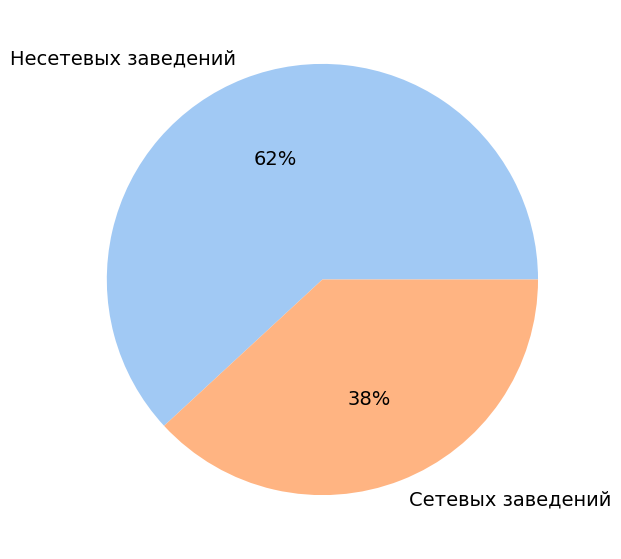

In [45]:
plt.figure(figsize=(7, 7))
y = chain_ratio['Количество']
mylabels = chain_ratio['Тип заведения']
colors = sns.color_palette('pastel')[ 0:5 ]
plt.pie(y, labels = mylabels,  autopct='%.0f%%', colors = colors,  textprops={'fontsize': 14})
plt.show(); 

**Вывод:**

Сетевых заведений меньше, чем несетевых почти во всех категориях заведений.

Самые большие проценты среди сетевых заведений в следующих категориях:

- 60% булочная
- 50% кофейня и пиццерия
- 40% ресторан и быстрое питание

Самые большие проценты среди несетвых заведений в следующих категориях:

- 80% бар,паб
- 70% столовая, кафе
- 60% быстрое питание, ресторан

### Анализ заведений по названию

Сгруппируем данные по названиям заведений и найдём топ-15 популярных сетей в Москве.

In [46]:
top_15 = df.query('chain == 1').groupby(['name', 'category'])['name'].count().sort_values(ascending=False).to_frame().head(15)
top_15.columns = ['count']
top_15 = top_15.reset_index(level=0).reset_index(level=0).sort_values(by='count',ascending=False)
top_15

,category,name,count
0,кофейня,шоколадница,119
1,пиццерия,домино'с пицца,76
2,пиццерия,додо пицца,74
3,кофейня,one price coffee,71
4,ресторан,яндекс лавка,69
5,кофейня,cofix,65
6,ресторан,prime,49
7,кофейня,кофепорт,42
8,кафе,кулинарная лавка братьев караваевых,39
9,ресторан,теремок,36


In [47]:
top_15['rating'] = df['rating']

In [48]:
top_15['rating'] = top_15['rating'].sort_values(ascending=False)

In [49]:
top_15['rating']

0     5.0
1     4.5
2     4.6
3     5.0
4     5.0
5     4.6
6     4.4
7     4.7
8     4.8
9     4.3
10    4.5
11    4.9
12    4.3
13    4.8
14    4.2
Name: rating, dtype: float64

Создадим функцию для построения графиков разброса расположенных на карте, чтобы в дальнейшем применять её, задав необходимые аргументы и значения.

In [50]:
def scatter_mapbox_creator(df, lat, lon, color=None, height=500, zoom=10, hover_data=None, hover_name=None):
    fig = px.scatter_mapbox(df, lat="lat", lon="lng", color='name', zoom=zoom, hover_name=hover_name, hover_data=hover_data)
    fig.update_geos(fitbounds="locations")
    fig.update_layout(
        margin={"r": 0, "t": 0, "l": 0, "b": 0},
        height=height,
        mapbox_style="carto-positron"
    )
    return fig

Построим визуализацию, применив функцию. Отрисуем топ-15 названий ведущих сетей на карте Москвы.

In [51]:
fig = scatter_mapbox_creator(df=df.query('chain == 1'), lat='lat', lon='lng', color='name', zoom=9, hover_name='name')
fig.show()

Построим также график самых популярных категорий среди 15 ведущих сетей.

In [52]:
fig = one_plot_creator(
    df=top_15,
    x='name', y='count', color='category', 
    title='Самые популярные категории среди 15 ведущих сетей',
    xaxis_title='Названия сетей', yaxis_title='Количество заведений',
    legend_title='Категории заведений', height=450
)
fig.show()

Построим график, отображающий средний рейтинг у топ-15 популярных сетей.

In [53]:
fig = one_plot_creator(
    df=top_15.groupby(['name'], as_index=False).agg(count=('rating', 'mean')).sort_values('count', ascending=False),
    x='name', y='count', color=None, 
    title='Средний рейтинг у топ-15 популярных сетей',
    xaxis_title='Название сети', yaxis_title='Рейтинг',
    showlegend=False, barmode='group'
)
fig.update_layout(
    yaxis_range=[3.8, 5.0],
    height=450
)
fig.show()

**Вывод:**

Составив топ 15 самых популярных заведений, получили:

- Все заведения, входящие в топ-15 являются сетевыми
- Почти все заведения, либо расположены в центре города, либо равномерно покрывают все районы
- Самые популярные категории среди 15 популярных сетей являются кофейни, кафе, рестораны, пиццерии и булочные
- Средний рейтинг у всех категорий заведений среди 15 популярных сетей находится в промежутке от 3.9 до 4.5 что является не плохим рейтингом.
- Данных по среднему чеку и цене чашки капучино очень мало, поэтому по ним сказать нечего

Самыми популярными сетями в категории кофейни:

- Шоколадница - 119 заведений
- One price coffe - 72 заведения
- Cofix - 65 заведений

Самыми популярными сетями в категории кафе:

- Кулинарная лавка братьев Караваевых - 39 заведений
- Drive cafe - 24 заведения
- Му-му - 12 заведений

Самыми популярными сетями в категории ресторан:

- Яндекс лавка - 69 заведений
- Prime - 49 заведения
- Теремок - 36 заведений

Самыми популярными сетями в категории булочная:

- Буханка -25 заведений

Самыми популярными сетями в категории пиццерия:

- Домино'c пицца - 77 заведений
- Dodo пицца - 24 заведения


### Анализ по административным районам Москвы

Проанализируем административные районы города Москва

Создадим функцию, которая выделит нам комбинацию по первым буквам наших административных районов для наглядности.

In [54]:
def make_acronym(phrase):
    phrase = phrase.replace('-', ' ').split()
    acronym = ""
    for word in phrase:
        acronym = acronym + word[0].upper()
    return acronym

Применим функцию к столбцу district.

In [55]:
df['district_short'] = df['district'].apply(make_acronym)

Подготовим сводную таблицу под график sunburst.

In [56]:
district_count = df.groupby(
    ['district', 'category'], as_index=False).agg(count=('name', 'count'))
district_count['district'] = district_count['district'].apply(make_acronym)
district_count['parent'] = district_count['district']
district_count['district'] = district_count['category']
district_count.loc[len(district_count.index)] = [
    "Москва", '', district_count['count'].sum(), '']

for d in district_count['parent'].unique():
    district_count.loc[len(district_count.index)] = [
        d, '', district_count[district_count['parent'] == d]['count'].sum(), 'Москва']

Построим наглядный график по распределению категорий заведений по административынм районам Москвы.

In [57]:
fig = px.sunburst(
    district_count,
    names='district',
    parents='parent',
    values='count',
    branchvalues="total",
    title='Распределение категорий заведений по административным районам Москвы'
)
fig.update_layout(
    grid=dict(columns=2, rows=1),
    margin=dict(t=50, l=0, r=0, b=0),
    height=800
)
fig.show()

Подготовим таблицу для построения графика.

In [58]:
district_count = (
    df.groupby(['district_short', 'category'], as_index=False)
    .agg(count=('name', 'count')).sort_values('count', ascending=False)
)

Сделаем график по распределению категорий заведений по административынм районам Москвы при помощи гистограммы.

In [59]:
fig = one_plot_creator(
    df=district_count,
    x='district_short', y='count', color='category', 
    title='Распределение категорий заведений по административным районам Москвы',
    xaxis_title='Административный район Москвы', yaxis_title='Количество заведений',
    legend_title='Категории заведений', barmode='group',height=600
)
fig.show()

**Вывод:**

- Судя по получившимся графикам больше всего количетсво заведений в ЦАО по всем категориям заведений. Так можно заметить отличительную особенность от других районов, в центре города Москвы очень большое количество ресторанов.(всего 2242 из них рестораны - 670) 
- В остальных районах города Москвы количество заведений не сильно отличается и даже есть какая схожесть между ними (от 700 до 900)
- Выделить можно только СЗАО в котором меньше всего количество заведений (409)
- В других районах помимо ЦАО преобладает такая категория как кафе этот момент отчетливо виден на гистограмме.

### Анализ рейтинга заведений

Проанализируем рейтинги заведений по категориям и административным районам.

Посмотрим на уникальные названия административных районов города Москва.

In [60]:
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

Создадим сводную таблицу с нужными нам данными.

In [61]:
rating_df = df.pivot_table(index='district', values='rating', aggfunc='mean').reset_index()
rating_df.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.377520
2,Северный административный округ,4.239778
4,Северо-Западный административный округ,4.208802
8,Южный административный округ,4.184417
1,Западный административный округ,4.181551
0,Восточный административный округ,4.174185
7,Юго-Западный административный округ,4.172920
3,Северо-Восточный административный округ,4.148260
6,Юго-Восточный административный округ,4.101120


Загрузим файл geojson для прорисовки границ наших администартивных районов.

In [62]:
import json

with open('admin_level_geomap.geojson', 'r',encoding='utf-8') as f:
    geo_json = json.load(f)
    
print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

Соответсвенно построим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

In [63]:
from folium import Map, Choropleth

moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=geo_json,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='RdPu',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по административным районам',
).add_to(m)
m

Теперь посмотрим на средние рейтинг по категориям в зависимости от административного района.

Создадим специальную таблицу с необходимыми данными.

In [64]:
rating_dist_cat = (
    df.groupby(['category', 'district_short'], as_index=False)
    .agg(count=('rating', 'mean')).sort_values('count', ascending=False)
)

Потсроим график со средним рейтингом в заведения по категориям для каждого административного района города Москвы.

In [65]:
fig = one_plot_creator(
    df=rating_dist_cat,
    x='district_short', y='count', color='category', 
    title='Средний рейтинг в заведениях по категориям',
    xaxis_title='Административный район', yaxis_title='Средний рейтинг',
    legend_title='Категории заведений', barmode='group'
)
fig.update_layout(
    yaxis_range=[3.9, 4.5],
    height=450
)
fig.show()

**Вывод:**

По графикам можно сказать следующее:

- Самый высокий рейтинг среди категорий заведений по всем административным районам у баров и пабов
- Следом идут и примерно в одном оценочном диапазоне пиццерии, кофейни и рестораны
- Самый низкий рейтинг почти по всем административным районам у таких категорий заведений как быстрое питание и кафе
- Самым рейтинговым районом по количеству оценок заслуженно является ЦАО центр города Москва
- Административным районом с самыми низкими оценками является ЮВАО

### Отображение всех заведений с помощью кластеров

Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium

In [66]:
from folium import Map, Marker
from folium.plugins import MarkerCluster

moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

df.apply(create_clusters, axis=1)

m

### Топ-15 улиц по количеству заведений

Проанализируем улицы города Москвы по количеству заведений общественного питания и составим Топ-15 улиц.

Для начала сгруппируем и отберем топ-15 улиц по количеству заведений.

In [67]:
streets = df.groupby('street').agg(count=('name', 'count')).sort_values(
    'count', ascending=False).head(15).index.tolist()
street_cat = df[df['street'].isin(streets)].groupby(['street', 'category'], as_index=False).agg(
    count=('name', 'count')).sort_values('count', ascending=False)

Подготовим визуализацию в виде графика определяющего топ-15 улиц по количеству заведений.

In [68]:
fig = one_plot_creator(
    df=street_cat,
    x='count', y='street', color='category', text='count',
    title='Топ-15 улиц по количеству заведений',
    xaxis_title='Количество заведений', yaxis_title='Названия улиц',
    legend_title='Категории заведений',
    orientation='h'
)
fig.show()

**Вывод:**

По графику видно:

- Больше всего количества заведений общественного питания находится на таких улицах как: проспект мира, улица профсоюзная, проспект вернадского и ленинский проспект. Предположительно это обусловлено тем, что это широкие и длинные улицы.
- Самые популярные категории заведений  это кафе и ресторан, далее идут кофейни, быстрое питание и пиццерии
- Самое минимальное количество заведений расположено на улице пятницкой

### Улицы, на которых находится только один объект общепита

Проанализируем улицы города Москва на которых находится только один объект общепита.

Сгруппируем данные и отберем только те улицы на которых находится только один объект общественного питания.

In [69]:
single_cafe = df.groupby('street').agg(count=('name', 'count')).sort_values(
    'count', ascending=False).query('count == 1').index.tolist()
single_cafe_street = df[df['street'].isin(single_cafe)].groupby(
    'category', as_index=False).agg(count=('name', 'count')).sort_values('count', ascending=False)

Соответственно выведем график, показывающий количество улиц на которых находится только один объект общепита по категориям.

In [70]:
fig = one_plot_creator(
    df=single_cafe_street,
    x='count', y='category', color='category', text='count',
    title='Количество улиц на которых находится только один объект общепита по категориям',
    xaxis_title='Количество улиц', yaxis_title='Категории заведений',
    showlegend=False,
    orientation='h',
    height=450
)
fig.show()

**Вывод:**

По графику видно:

- Категорией заведения на улицах на которых находится только один объект общепита является чаще всего кафе, получается, что в Москве 158 улиц на котрых находится по одному кафе.
- Следом идут улицы на которых расположены по одному ресторану и одной кофейни, таких улиц в Москве 93
- Всех остальных категорий заведений очень мало
- Можно предположить что связано это с тем, что такие заведения как столовая, бар, пиццерия и быстрое питание, открывают там где большой поток клиентов и большое число объектов общепита.
- А кафе, рестораны и кофейни могут открывать в местах где нет конкурентов и без огромной проходимости, судя по полученным данным так и есть

### Анализ значений средних чеков

Проанализируем значения средних чеков заведений общественного питания города Москва.

Сгруппируем данные и посчитаем медианное значение среднего чека.

In [71]:
dist_avg_bill = df.groupby('district', as_index=False).agg(
    avg_bill=('middle_avg_bill', 'median'))
dist_avg_bill['avg_bill'] = round(dist_avg_bill['avg_bill'], 2)

Создадим функцию для построения фоновой картограммы (хороплета). 

In [72]:
def choropleth_mapbox_creator(df,color,locations,
                              geojson,
                              featureidkey='properties.name',
                              center={"lat": 55.751244, "lon": 37.618423},
                              zoom=8.7, opacity=.7,height=500,
                              hover_name=None):

    fig = px.choropleth_mapbox(df,
                               geojson=geojson,
                               color=color,
                               locations=locations,
                               featureidkey=featureidkey,
                               center=center,
                               zoom=zoom, opacity=opacity,
                               hover_name=hover_name
                               )
    fig.update_geos(fitbounds="locations")
    fig.update_layout(
        margin={"r": 0, "t": 0, "l": 0, "b": 0},
        height=height,
        mapbox_style="carto-positron"
    )
    return fig

Построим фоновую картограмму (хороплет) с полученными значениями среднего чека для каждого административного района города Москва. 

In [73]:
fig = choropleth_mapbox_creator(
    df=dist_avg_bill,
    geojson=geo_json,
    color='avg_bill',
    locations='district',
    opacity=.8,height=500,
    hover_name='avg_bill')
fig.show()

**Вывод:**

- Самый большой средний чек в ЦАО и ЗАО это соответсвенно самый центр Москвы и самый дорогой административынй район города Москвы
- Самые небольшие средние чеки в СВАО, ЮАО и ЮВАО
- Остальные административные районы не сильно отличаются друг от друга
- В целом можно сделать такой вывод, что отдаление от центра Москвы дальше чем за ЦАО не сильно влияет на средний чек, дальше работает правильно "дорогой район - дороже, дешевый - дешевле"

### Анализ заведений, которые работают круглосуточно

Проанализируем заведения, которые работают круглосуточно.

Построим визуализацию на который отобразим количество заведения которые работают круглосуточно по административным районам города Москва.

In [74]:
fig = choropleth_mapbox_creator(
    df=df.query('is_24_7==True').groupby('district', as_index=False).agg(is_24_7=('is_24_7', 'count')),
    geojson=geo_json,
    color='is_24_7',
    locations='district',
    opacity=.8,height=500,
    hover_name='is_24_7')
fig.show()

Отобразим это еще и на графике по категориям заведений.

In [75]:
fig = one_plot_creator(
    df=df.query('is_24_7==True').groupby('category', as_index=False).agg(is_24_7=('is_24_7', 'count')).sort_values('is_24_7', ascending=False),
    x='is_24_7', y='category', color='category', text='is_24_7',
    title='Количество заведений, которые работают круглосуточно по категориям',
    xaxis_title='Количетсво заведений', yaxis_title='Категории заведений',
    showlegend=False,
    orientation='h',
    height=450
)

fig.show()

**Вывод:**

- Больше всего как мы видим круглосуточных заведений в ЦАО города Москвы. Центр Москвы никогда не спит)
- Следом идут ВАО и ЮВАО по количеству круглосуточных заведений
- Минимальное число круглосуточных заведений находится в СЗАО
- Чаще всего круглосуточными заведениями являются такие категории как кафе, быстрое питание и рестораны
- Остальные категории заведений сильно меньше, 
- Минимальное количество круглосуточных заведений занимают такие категории как столовая и булочная

### Анализ заведений с низкими и высокими рейтингами

Проанализируем заведения общественного питания города Москва с низкими и высокими рейтингами.

Для начала выведем статистику по рейтингу и определим минимальный, максимальный рейтинг, а также средний рейтинг.

In [76]:
df['rating'].describe()

count    8406.000000
mean        4.229895
std         0.470348
min         1.000000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

- За низкий рейтинг примем заведения с рейтингом ниже 4.1 (таких заведений примерно 25%)
- За высокий рейтинг примем заведения с рейтингом выше 4.4 (таких заведений тоже примерно 25%)

Создадим функию для определения соотношения рейтингов.

In [77]:
def ratio_rating(row):
    category = row['category']
    len_by_rat = row['count']
    len_all = df.query('category == @category ')['name'].size
    return round(len_by_rat/len_all * 100, 2)

Для начала сгруппируем данные согласно низкому и высокому рейтингу. Также выделим средний чек для таких категорий заведений.

In [78]:
low_rating = (
    df.query('rating < 4.1')
    .groupby('category', as_index=False)
    .agg(avg_bill=('middle_avg_bill', 'mean'), count=('lat', 'count'))
    .sort_values('count', ascending=False)
)

low_rating['avg_bill'] = round(low_rating['avg_bill'], 1)
low_rating['count_ratio'] = low_rating.apply(ratio_rating, axis=1)

high_rating = (
    df.query('rating > 4.4')
    .groupby('category', as_index=False)
    .agg(avg_bill=('middle_avg_bill', 'mean'), count=('name', 'count'))
    .sort_values('count', ascending=False)
)

high_rating['avg_bill'] = round(high_rating['avg_bill'], 1)
high_rating['count_ratio'] = high_rating.apply(ratio_rating, axis=1)

Постороим график с количеством заведений с низким и высоким рейтингом по категориям.

In [79]:
fig = go.Figure()

fig.add_trace(go.Bar(x=low_rating['category'], y=low_rating['count'], text=low_rating['count'],
                     name='Кол-во заведений с низким рейтингом', marker_color='rgb(238, 85, 59)'))


fig.add_trace(go.Bar(x=high_rating['category'], y=high_rating['count'], text=high_rating['count'],
                     name='Кол-во заведений с высоким рейтингом', marker_color='rgb(99, 110, 250)'))

fig.update_traces(marker_pattern_fgcolor='black')
fig.update_layout(
    height=600,
    showlegend=True,
    title='Количество заведений с низким и высоким рейтингом по категориям',
    xaxis_title='Категории заведений',
    yaxis_title='Количество заведений',
    legend_title='Количество заведений по рейтингам'
)
fig.show()

Построим график, показывающий средний чек в заведениях с низким и высоким рейтнгом по категориям.

In [80]:
fig = go.Figure()

fig.add_trace(go.Bar(x=low_rating['category'], y=low_rating['avg_bill'], text=low_rating['avg_bill'],
                     name='low rating', marker_color='rgb(238, 85, 59)'))

fig.add_trace(go.Bar(x=high_rating['category'], y=high_rating['avg_bill'], text=high_rating['avg_bill'],
                     name='high rating', marker_color='rgb(99, 110, 250)'))

fig.update_layout(
    height=450,
    showlegend=True,
    title='Средний чек в заведениях с низким и высоким рейтингом по категориям',
    xaxis_title='Категории заведений',
    yaxis_title='Средний чек',
    legend_title='Рейтинг заведения'
)
fig.show()

**Вывод:**

По рейтингу:

- Больше всего с высоким рейтингом ресторанов
- На втором и тертьем месте среди высоких рейтингов находятся кафе и кофейни
- Больше всего с низким рейтингом кафе
- На втором и тертьем месте среди низких рейтингов находятся рестораны и быстрое питание
- У столовых золотая середина по низким и высоким рейтингам
- У баров и пабов больше хороших рейтингов



По среднему чеку:

- Самый большой средний чек у ресторанов с большим рейтингом, что логично
- На втором месте идут бары и пабы с большим рейтингом
- На третьем месте идут пиццерии с большим рейтингом
- На первом месте среди заведения с низким рейтингом можно увидеть бары и пабы
- На вторм месте рестораны
- На третьем месте пиццерии

Прослеживется четкая зависимость суммы среднего чека от рейтинга заведения. Чем у заведения больше хороших рейтингов, тем соответственно будет больше средний чек.

Если заведение не столовая и не ресторан быстрого питания то иметь хорошие отзывы прибыльно (или затратно))
самая большая разница в среднем чеке между хорошими и плохими заведениями у ресторанов, баров и пиццерий

Удивительно по столовым у них средний чек среди заведений с низким рейтингом больше, чем у заведений с высоким рейтингом.

### Общий вывод:

Для работы были получены данные о заведениях общественного питания в г. Москва.

Была проведена предобработка данных: созданы новые столбцы с названием улиц и информацией о часах работы заведения которые работают ежедневно и круглосуточно

Была построена визуализация по категориям заведений. Данная визуализация показала, что наиболее популярные категории заведений:

- 28.3% - кафе - 2378 заведений,
- 24.3% - ресторан - 2043 заведений,
- 16.8% - кофейня - 1413 заведений

По количеству посадочных мест по категориям возглавляют следующие 3 категории заведений:

- Ресторан – 86 посадочных мест по медиане
- Бар/паб – 82 посадочных места по медиане
- Кофейня – 80 посадочных мест по медиане

Во всех категориях заведений доминирует категория заведений среднего размера (от 21 до 80 посадочных мест)
На втором месте из всех категорий идут заведения очень большего размера (от 121 посадочного места)
Замыкают тройку заведения большего размера (от 81 до 120 посадочных мест)
Заведения маленького размера находятся на предпоследнем месте среди категорий (от 1 до 20 посадочных мест)

По-видимому в данных категориях заведений люди любят проводить длительное время, чем и обосновывается количество посадочных мест.

Сетевых заведений меньше, чем несетевых почти во всех категориях заведений.

Самые большие проценты среди сетевых заведений в следующих категориях:

- 60% булочная
- 50% кофейня и пиццерия
- 40% ресторан и быстрое питание

Самые большие проценты среди несетвых заведений в следующих категориях:

- 80% бар,паб
- 70% столовая, кафе
- 60% быстрое питание, ресторан

Самыми популярными сетями в категории кофейни:

- Шоколадница - 119 заведений
- One price coffe - 72 заведения
- Cofix - 65 заведений

Самыми популярными сетями в категории кафе:

- Кулинарная лавка братьев Караваевых - 39 заведений
- Drive cafe - 24 заведения
- Му-му - 12 заведений

Самыми популярными сетями в категории ресторан:

- Яндекс лавка - 69 заведений
- Prime - 49 заведения
- Теремок - 36 заведений

Самыми популярными сетями в категории булочная:

- Буханка -25 заведений

Самыми популярными сетями в категории пиццерия:

- Домино'c пицца - 77 заведений
- Dodo пицца - 24 заведения

Топ-3 админстративных района по количеству заведений общепита:

- Центральный (ЦАО) - 2242 заведения
- Северный (САО) - 900 заведений
- Южный (ЮАО) - 892 заведения

На последнем месте по количеству заведения общепита находится - Северо-Западный (СЗАО)

Самый высокий рейтинг среди категорий заведений по всем административным районам у баров и пабов.
Следом идут и примерно в одном оценочном диапазоне пиццерии, кофейни и рестораны.
Самый низкий рейтинг почти по всем административным районам у таких ктегорий заведений как быстрое питание и кафе.
Самым рейтинговым районом по количеству оценок заслуженно является ЦАО центр города Москва.
Административным районом с самыми низкими оценками является ЮВАО.

Топ-15 улиц по количеству заведений:

- Больше всего количества заведений общественного питания находится на таких улицах как: проспект мира, улица профсоюзная, проспект вернадского и ленинский проспект. Предположительно это обусловлено тем, что это широкие и длинные улицы.
- Самые популярные категории заведений это кафе и ресторан, далее идут кофейни, быстрое питание и пиццерии
- Самое минимальное количество заведений расположено на улице пятницкой

Улицы, на которых находится только один объект общепита:

- Категорией заведения на улицах на которых находится только один объект общепита является чаще всего кафе, получается, что в Москве 158 улиц на котрых находится по одному кафе.
- Следом идут улицы на которых расположены по одному ресторану и одной кофейни, таких улиц в Москве 93
- Всех остальных категорий заведений очень мало

Можно предположить что связано это с тем, что такие заведения как столовая, бар, пиццерия и быстрое питание, открывают там где большой поток клиентов и большое число объектов общепита.
А кафе, рестораны и кофейни могут открывать в местах где нет конкурентов и без огромной проходимости, судя по полученным данным так и есть

По рейтингу:

- Больше всего с высоким рейтингом ресторанов
- На втором и тертьем месте среди высоких рейтингов находятся кафе и кофейни
- Больше всего с низким рейтингом кафе
- На втором и тертьем месте среди низких рейтингов находятся рестораны и быстрое питание
- У столовых золотая середина по низким и высоким рейтингам
- У баров и пабов больше хороших рейтингов

По среднему чеку:

- Самый большой средний чек у ресторанов с большим рейтингом, что логично
- На втором месте идут бары и пабы с большим рейтингом
- На третьем месте идут пиццерии с большим рейтингом
- На первом месте среди заведения с низким рейтингом можно увидеть бары и пабы
- На вторм месте рестораны
- На третьем месте пиццерии


## Детализация исследования: открытие кофейни

### Количество кофеен и их расположение

Посчитаем количество кофеен.

In [81]:
coffee_house = df.query('category == "кофейня"')['name'].shape[0]
print(f'Всего кофеен в датасете: {coffee_house}')

Всего кофеен в датасете: 1413


Сгруппируем данные по кофейням по администартивным районам.

In [82]:
coffee = df.query('category == "кофейня"').pivot_table(index='district', values='name', aggfunc='count').reset_index()\
.sort_values(by='name', ascending=False)
coffee.columns = ['district', 'count']

In [83]:
coffee

,district,count
5,Центральный административный округ,428
2,Северный административный округ,193
3,Северо-Восточный административный округ,159
1,Западный административный округ,150
8,Южный административный округ,131
0,Восточный административный округ,105
7,Юго-Западный административный округ,96
6,Юго-Восточный административный округ,89
4,Северо-Западный административный округ,62


Создадим визуализацию по количеству кофеен для каждого административного района города Москва.

In [84]:
fig = choropleth_mapbox_creator(
    df=coffee,
    geojson=geo_json,
    color='count',
    locations='district',
    opacity=.8,height=500,
    hover_name='count')
fig.show()

**Вывод:**

Количество кофеен по администартивным районам Москвы

- Центральный административный округ	- 428
- Северный административный округ	- 193
- Северо-Восточный административный округ	- 159
- Западный административный округ	- 150
- Южный административный округ	- 131
- Восточный административный округ	- 105
- Юго-Западный административный округ	- 96
- Юго-Восточный административный округ	- 89
- Северо-Западный административный округ	- 62

На карте видно, что:

- Как всегда больше всего кофеен в ЦАО и их количество 428 кофеен
- Следом за центром идет САО с количеством 193 кофейни
- Минимальные показатели по количеству кофеен показывают ЮВАО с 89 кофейнями и СЗАО с  62 кофейнями

### Есть ли круглосуточные кофейни?

Посчитаем процентное соотношение круглосуточных кофеен по отношению к общему количеству.

In [85]:
df.query('category == "кофейня"')['is_24_7'].mean()*100

4.220314735336195

Посмотрим на режимы работы кофеен представленных в Москве.

In [86]:
df.query('category == "кофейня"')['hours'].value_counts().head(10)

ежедневно, 10:00–22:00                  140
ежедневно, 08:00–22:00                   60
ежедневно, круглосуточно                 59
ежедневно, 09:00–22:00                   57
пн-пт 08:00–19:00                        46
пн-пт 08:00–21:00; сб,вс 09:00–21:00     46
ежедневно, 09:00–21:00                   43
пн-пт 08:00–22:00; сб,вс 09:00–22:00     42
ежедневно, 08:00–21:00                   36
пн-пт 08:00–18:30                        34
Name: hours, dtype: int64

**Вывод:**

Круглосуточные кофейни – достаточно редкое явление. Таких кофеен всего 4,2%, что в абсолютных показателях – 59 заведений. В основном кофейни работают с утра и до позднего вечера.

### Рейтинг кофеен по районам и цены на чашечку капучино 

Проанализируем рейтинг кофеен по районам и по цене на чашечку капучино.

Определим наши кофейни.

In [87]:
cafe = df.query('category == "кофейня"')

Сгруппируем необходимые данные, посчитаем количество и среднее значение.

In [88]:
cafe_rating_cost = cafe.groupby(by='district_short', as_index=False).agg(
    count=('rating', 'mean'), avg_cup=('middle_coffee_cup', 'mean'))
cafe_rating_cost['count'] = round(cafe_rating_cost['count'], 2)
cafe_rating_cost['avg_cup'] = round(cafe_rating_cost['avg_cup'])

Выведем сразу два графика, которые показывают средний рейтинг кофеен по районам и среднюю цену за чашку капучино по районам.

In [89]:
colors_1 = ['rgb(238, 85, 59)',] * 9
colors_1[3] = 'rgb(0, 204, 151)'

color_2 = ['rgb(97, 70, 255)',] * 9
color_2[2] = 'rgb(0, 204, 151)'

fig = make_subplots(rows=1, cols=2,
                    x_title='Административный район',
                    subplot_titles=('Средний рейтинг кофеен по районам',
                                    'Средняя цена чашки капучино по районам'))

cafe_rating_cost = cafe_rating_cost.sort_values('count', ascending=False)
fig.append_trace(go.Bar(x=cafe_rating_cost['district_short'], y=cafe_rating_cost['count'], text=cafe_rating_cost['count'],
                        marker_color=colors_1), row=1, col=1)

cafe_rating_cost = cafe_rating_cost.sort_values('avg_cup', ascending=False)
fig.add_trace(go.Bar(x=cafe_rating_cost['district_short'], y=cafe_rating_cost['avg_cup'], text=cafe_rating_cost['avg_cup'],
                     name='count low rating', marker_color=color_2), row=1, col=2)

fig['layout']['yaxis']['title'] = 'Средний рейтинг'
fig['layout']['yaxis2']['title'] = 'Средняя цена чашки капучино'

fig.update_layout(
    height=450,
    showlegend=False,
    yaxis2=dict(range=[140, 195]),
    yaxis1=dict(range=[4, 4.4]))

fig.show()

**Вывод:**

Средний рейтинг кофеен по районам:

- Лучшие рейтинги показывают три района ЦАО, СЗАО и САО
- Самые низкие рейтинги показывают районы ЗАО, СВАО, ЮВАО и ЮАО
- Среднее значение рейтинга показывает ВАО

По цене за чашку капучино:

- Самое дорогое капучино можно купить в ЗАО
- Самое дешевое капучино можно купить в ЮВАО
- Средняя стоимость капучино в ЮЗАО

Рассмотрим поближе Юго-Западный административный округ города Москва (ЮЗАО)

Для начала выделим кофейни из этого района.

In [90]:
only_UZAO = cafe.query('district_short == "ЮЗАО"')
only_UZAO['middle_coffee_cup'] = round(
only_UZAO['middle_coffee_cup'].fillna(only_UZAO['middle_coffee_cup'].mean()))

Отрисуем на карте района маркеры с кофейнями и посмотрим на их расположение, а также отобразим рейтинг этих кофеен.
Цвета говорят о рейтинге кофеен.
Размер маркера говорит о цене за чашку капучино.

In [91]:
fig = px.scatter_mapbox(only_UZAO, lat="lat", lon="lng",
                        size='middle_coffee_cup', color='rating',
                        zoom=10.5, hover_name="name", hover_data=["category", "rating"])
fig.update_geos(fitbounds="locations")
fig.update_layout(
    margin={"r": 0, "t": 0, "l": 0, "b": 0},
    mapbox_style="carto-positron",
    height=500,
)
fig.show()

**Вывод:**

На карте видно:

- Свободных мест в которых можно открыть кофейню очень много, видны пробелы не только на окраинах района, но даже и на центральных улицах района. Места есть
- Много кофеен с низким рейтингом
- Мало кофеен с высоким рейтингом
- В основном кофейни со средним рейтингом
- Почти все кофейни одинаковы в плане цены за чашку капучино, выделяются конечно и дешевые кофейни
- Типичный спальный район с обильным количеством парков и центральных улиц 
- Граничит с москвой-рекой

### Общий вывод

Проанализировав все данные что у нас есть по кофейням города Москва
Основателям фонда «Shut Up and Take My Money» для осуществления своей мечты необходимо учитывать следующие факторы:

Рекомендации для открытия доступной кофейни:
- Кофейни находятся на 3-м месте среди всех заведений по популярности
- Режим работы – ежедневный с 10:00 – 22:00
- Ориентировочная стоимость чашки капучино 180 рублей
- Можно открываться на улицах, где наша кофейня будет единственной
- Ориентироваться на количество посадочных мест от 21 до 80
- Средний чек может варьироваться от 300 до 600 рублей
- Как вариант приобрести франшизу одной из популярных сетей кофеен
- Главное поддерживать сервис обслуживания на высоком уровне
- Хорошее кофе – высокие рейтинги

Лучший район для открытия новой и доступной кофейни:
- Юго-Западный административный район (ЮЗАО)
- Цена за кружку капучино будет составлять примерно  180 рублей
- Цена аренды кв.м коммерческой недвижимости возможно будет ниже чем в других районах города Москвы
- Свободные места для открытия доступной кофейни в этом районе есть как на центральных улицах (даже возле метро), так и парковых (зеленых) зонах и спальных районах. Есть из чего выбрать.
- По соотношению расходов, количества потенциальных клиентов, количеству конкурентов и перспектив в ближайшем будущем один из лучших (если не самый лучший) административный район в Москве

Если немного конкретизировать то по Юго-Западному административному району получается следующее:

- Один из самых низких показателей по индексу кофеин на человека (источник statdata.ru, wikipedia.org)
- Один из самых дорогих средних чашек кофе по районам
- Один из самых низких показателей стоимости аренды по районами (источник msk.restate.ru)
- Один из самых высоких показателей по строящихся зданий (источник bnMAP.pro)
- Достаточно низкий средний рейтинг кофеин по району
- Также анализ карты показывает, что для открытия такого типа заведения, есть "очень приятные" места

Получается, что исторические условия предопределили статус юго-запада на годы вперед. Окружение стало влиять на среду вокруг — и ЮЗАО начал как магнит притягивать к себе москвичей, желающих улучшить качество жизни за счет переезда в более чистый и удобный район.


Презентация: <https://disk.yandex.ru/d/upy7FqOSQ7dbUg>